<h1><center>Cloud Cover spatiotemporal prediction using deep learning</center></h1>

<center><a href='https://notebook.wekeo.eu/'> 
    <img src='https://www.copernicus.eu/sites/default/files/inline-images/Picture2_21.png' width="500"> 
</a></center>

<hr>

# Introduction

In this Jupyter Notebook you will learn how to query ERA5 data from WEkEO, explore it, and pre-process it for predicting the spatiotemporal variability of the phenomena. For this case study we use total cloud cover data over France.

### The data

[ERA5](https://cds.climate.copernicus.eu/cdsapp#!/dataset/reanalysis-era5-single-levels?tab=overview) is a reanalysis dataset providing hourly estimates of a large number of atmospheric, land and oceanic climate variables. The data covers the Earth on a 30km grid and resolve the atmosphere using 137 levels from the surface up to a height of 80km. ERA5 includes information about uncertainties for all variables at reduced spatial and temporal resolutions.

From this dataset we use the Total Cloud Cover (TCC) estimation. This parameter is the proportion of a grid box covered by cloud. Total cloud cover is a single level field calculated from the cloud occurring at different model levels through the atmosphere. Assumptions are made about the degree of overlap/randomness between clouds at different heights. Cloud fractions vary from 0 to 1.

In addition, we use [Sentinel-3 Ocean and Land Colour Instrument (OLCI)](https://sentinels.copernicus.eu/web/sentinel/user-guides/sentinel-3-olci) cloud mask product to compare TCC values. OLCI has a resolution of 300m which is 100 times more detailed than ERA5, thus allowing us to evaluate the performance of the reanalysis with finer observations. 


### Hold on, what's a climate reanalysis?

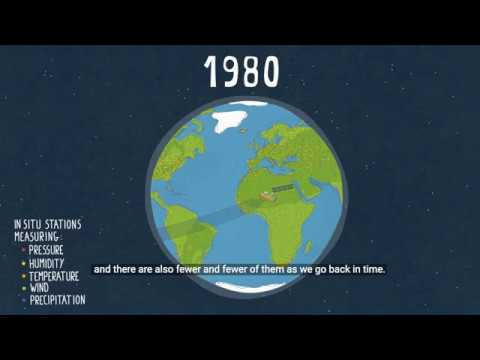

In [4]:
from IPython.display import YouTubeVideo

YouTubeVideo('FAGobvUGl24', width=800, height=450)

### Table of Contents

* [Data access and download](#chapter1)
    * [Importing libraries](#section_1_1)
    * [Creating and sending download query](sSection_1_2)
* [Data Exploration and pre processing](#chapter2)
    * [Importing libraries](#section_2_1)
    * [Loading data](#section_2_2)
    * [Plotting temporal data](#section_2_3)
    * [Plotting geographical data](#section_2_4)
    * [Animating spatio-temporal data](#section_2_5)
* [Next-frame prediction](#chapter3)
    * [Importing libraries](#section_3_1)
    * [Defining the model](sSection_3_2)
    * [Tranning the model](sSection_3_3)
    * [Making predictions](sSection_3_4)



## Data access and download <a class="anchor" id="chapter1"></a>


### Importing libraries <a class="anchor" id="section_1_1"></a>


We will use the Harmonized Data Access services to search and download the data. For this Wekeo has created a python client for the API which makes this process easier. Next we will import that Client, define the query json and send a request for downlading ERA5 TCC data. Currently this data is provided world wide, so it must be cropped according to a specific AOI. 

In [1]:
import hda # Wekeo's python Client for HDA 
import os # To manage folder basic operations

### Creating and sending download query <a class="anchor" id="section_1_2"></a>


Next we need to define a JSON, a dictionary of data to comunicate with the API. This JSON contains information such as ERA5 collection ID, our variable of interest and the range period we are want to study which will be filled with the variables defined in the following block. For this example we will use hourly data from 2017 to 2021, including all months of the year. We will also define the directory in which we want the data to be downloaded.

In [4]:
#Sequences for years, months and days
Years=list(map(str,range(2017,2022,1))) 
months=list(map(str,range(1,13,1)))
days=list(map(str,range(1,31,1)))
# Working dir (download data)
workdir=c=''

In [5]:
Years #How the years sequence looks like

['2017', '2018', '2019', '2020', '2021']

In [6]:
query = {
  "datasetId": "EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS",

  "multiStringSelectValues": [
    {
      "name": "variable",
      "value": [
        "total_cloud_cover"
      ]
    },
    {
      "name": "product_type",
      "value": [
        "reanalysis"
      ]
    },
    {
      "name": "year",
      "value": Years
    },
    {
      "name": "month",
      "value": months
    },
    {
      "name": "day",
      "value": days
    },
    {
      "name": "time",
      "value": [
        "00:00",
        "01:00",
        "02:00",
        "03:00",
        "04:00",
        "05:00",
        "06:00",
        "07:00",
        "08:00",
        "09:00",
        "10:00",
        "11:00",
        "12:00",
        "13:00",
        "14:00",
        "15:00",
        "16:00",
        "17:00",
        "18:00",
        "19:00",
        "20:00",
        "21:00",
        "22:00",
        "23:00"
      ]
    }
  ],
  "stringChoiceValues": [
    {
      "name": "format",
      "value": "netcdf"
    }
  ]
}

Now we create an hda client instance and pass the query. The next bock will search for the data and download it to your working directory, it migth take long as it will only stop when all the data is downloaded.

In [ ]:
c=hda.Client(debug=True)
matches=c.search(query)
os.chdir(workdir)
matches.download()

## Data exploration and pre-processing <a class="anchor" id="chapter1"></a>


### Importing libraries <a class="anchor" id="section_2_1"></a>


For this section we will use libraries to work with multidimensional data arrays stored in netCDF4 format. We will also use some packages to plot them and create maps.

In [2]:
# To work with multidimentional arrays
import netCDF4
import xarray as xr
import numpy

# To create plots and maps
import plotly.graph_objects as go

import matplotlib.pyplot as plt
import matplotlib.colors
from matplotlib.cm import get_cmap
from matplotlib import animation
from matplotlib.axes import Axes

import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature
from cartopy.mpl.geoaxes import GeoAxes
GeoAxes._pcolormesh_patched = Axes.pcolormesh

from IPython.display import HTML


##### Esto hay que moverlo

In [ ]:
def visualize_pcolormesh(data_array, longitude, latitude, projection, color_scale, unit, long_name, vmin, vmax, 
                         set_global=True, lonmin=-180, lonmax=180, latmin=-90, latmax=90):
    """ 
    Visualizes a xarray.DataArray with matplotlib's pcolormesh function.
    
    Parameters:
        data_array(xarray.DataArray): xarray.DataArray holding the data values
        longitude(xarray.DataArray): xarray.DataArray holding the longitude values
        latitude(xarray.DataArray): xarray.DataArray holding the latitude values
        projection(str): a projection provided by the cartopy library, e.g. ccrs.PlateCarree()
        color_scale(str): string taken from matplotlib's color ramp reference
        unit(str): the unit of the parameter, taken from the NetCDF file if possible
        long_name(str): long name of the parameter, taken from the NetCDF file if possible
        vmin(int): minimum number on visualisation legend
        vmax(int): maximum number on visualisation legend
        set_global(boolean): optional kwarg, default is True
        lonmin,lonmax,latmin,latmax(float): optional kwarg, set geographic extent is set_global kwarg is set to 
                                            False

    """
    fig=plt.figure(figsize=(20, 10))

    ax = plt.axes(projection=projection)
   
    img = plt.pcolormesh(longitude, latitude, data_array, 
                        cmap=plt.get_cmap(color_scale), transform=ccrs.PlateCarree(),
                        vmin=vmin,
                        vmax=vmax,
                        shading='auto')

    ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=1)
    ax.add_feature(cfeature.COASTLINE, edgecolor='black', linewidth=1)

    if (projection==ccrs.PlateCarree()):
        
        ax.set_extent([lonmin, lonmax, latmin, latmax], projection)
        gl = ax.gridlines(draw_labels=True, linestyle='--')
        gl.top_labels=False
        gl.right_labels=False
        gl.xformatter=LONGITUDE_FORMATTER
        gl.yformatter=LATITUDE_FORMATTER
        gl.xlabel_style={'size':14}
        gl.ylabel_style={'size':14}

    if(set_global):
        ax.set_global()
        ax.gridlines()

    cbar = fig.colorbar(img, ax=ax, orientation='horizontal', fraction=0.04, pad=0.1)
    cbar.set_label(unit, fontsize=16)
    cbar.ax.tick_params(labelsize=14)
    ax.set_title(long_name, fontsize=20, pad=20.0)

 #   plt.show()
    return fig, ax

### Loading data <a class="anchor" id="section_2_2"></a>


Xarray extends numpy structures to handle labeled data. It makes easy to work with coordinates, attributes and multiple dimensions which makes them a powerful tool to hanlde temporal gridded geographical data. For example we can easly subset the worldwide data downladed to a specific AOI based on geographic coordinates. 

In [3]:
data=xr.open_dataset(r'C:\Users\jegom\Desktop\data\merged.nc')
data=data.tcc
data

<xarray.DataArray 'tcc' (time: 38184, latitude: 55, longitude: 55)>
[115506600 values with dtype=float32]
Coordinates:
  * longitude  (longitude) float32 -4.75 -4.5 -4.25 -4.0 ... 8.0 8.25 8.5 8.75
  * latitude   (latitude) float32 53.75 53.5 53.25 53.0 ... 40.75 40.5 40.25
  * time       (time) datetime64[ns] 2017-01-01 ... 2021-11-29T23:00:00
Attributes:
    units:          (0 - 1)
    long_name:      Total cloud cover
    standard_name:  cloud_area_fraction

In [ ]:
file_assigned = data.assign_coords(longitude=(((data.longitude + 180) % 360) - 180)).sortby('longitude')
croped=file_assigned.where((file_assigned.latitude < 54) & (file_assigned.latitude > 40) & (file_assigned.longitude < 9) & (file_assigned.longitude > -5),drop=True)

#Tal vez hacer esto una funcion crop_data?

### Plotting temporal data <a class="anchor" id="section_2_3"></a>


It is possible to use the dimensional nature of xarray to perform operations on the data. For example, using temporal labeling we can calculate the mean TCC for each timestamp and analize the corresponding time series to identify patterns and other behaviors of interest. As we have very long time series, the use of plotly interactive charts allows to explore diferent temporal scales and move along the whole temporal window.

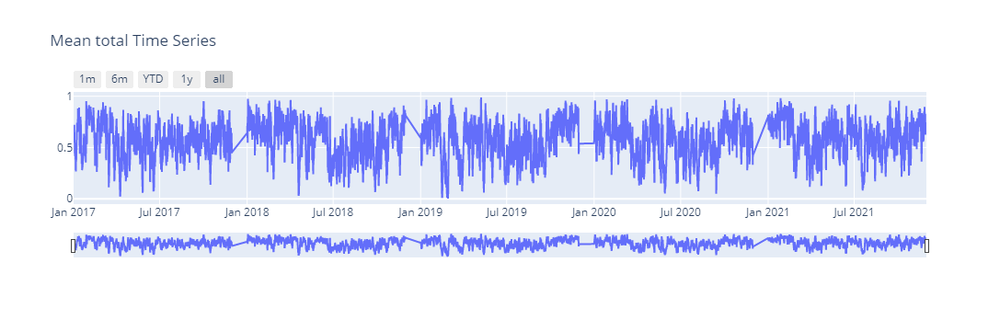

In [23]:
# Create figure
fig = go.Figure()
fig.add_trace(go.Scatter(x=list(data.time.values.astype('str')), y=list(data['tcc'].mean(axis=(1,2)).values)))
# Set title
fig.update_layout(
    title_text="Mean total Cloud Cover Time Series")


# Add range slider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
                dict(count=6,
                     label="6m",
                     step="month",
                     stepmode="backward"),
                dict(count=1,
                     label="YTD",
                     step="year",
                     stepmode="todate"),
                dict(count=1,
                     label="1y",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

fig.show()

### Plotting geographical data <a class="anchor" id="section_2_4"></a>


Making use of the visualize_colormesh function we can select a specific time of interest and plot it avobe a reference map to analyze the spatial distribution of the clouds in that particular snapshot.

(<Figure size 1440x720 with 2 Axes>,
 <GeoAxesSubplot:title={'center':'Total Cloud Cover 2017-01-01T01:00:00.000000000'}>)

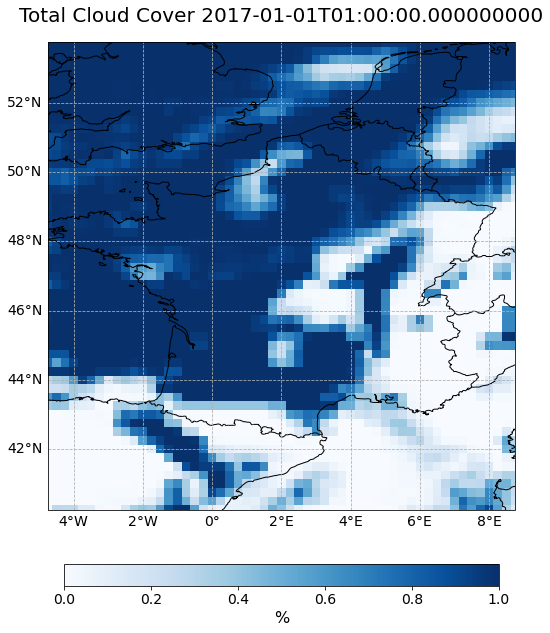

In [41]:
visualize_pcolormesh(data_array=data.sel(time='2017-01-01T02:00:00.000000000'),
                     longitude=data.longitude,
                     latitude=data.latitude,
                     projection=ccrs.PlateCarree(),
                     color_scale='Blues',
                     unit='%',
                     long_name= 'Total Cloud Cover ' + str(data.time.data[1]),
                     vmin=0, 
                     vmax=1,
                     lonmin=data.longitude.min().data,
                     lonmax=data.longitude.max().data,
                     latmin=data.latitude.min().data,
                     latmax=data.latitude.max().data,
                     set_global=False)

### Animating spatio-temporal data <a class="anchor" id="section_2_5"></a>



Going even further, we can use the temporal dimension of the data to create animations on temporal subsets. In this case, the data can be thought as a video in which each hour is a new frame.

Animation size has reached 21002416 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


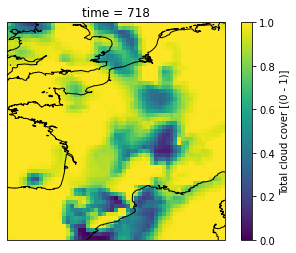

In [62]:
variable = data.sel(time=slice('2017-01-01T01:00:00.000000000', '2017-02-01T23:00:00.000000000'))
fig = plt.figure()
ax = plt.axes(projection=ccrs.PlateCarree())
image = variable.isel(time = 0).plot.imshow(ax=ax, transform=ccrs.PlateCarree(), animated=True)
ax.coastlines()
def update(t):
    # Update the plot for a specific time
    ax.set_title("time = %s"%t)
    image.set_array(variable.isel(time=t))
    return image,
anim = animation.FuncAnimation(fig, update, frames=len(variable.time.values))
display(HTML(anim.to_jshtml()))

Now we wanto to transform the data in such a way that a Deep Learning model can hanlde it. For this we first convert the xarray into a numpy array, whitout labels where only the TCC values are keeped. this array has 3 dimensions: first the temporal one, in this case 38184, each of this coresponding to a diferent hour the remaning two dimentions corespond to latitude-longitude grid. 

In [5]:
tcc_array=data.to_numpy()
tcc_array.shape

(38184, 55, 55)

This means that, as it is, we have onse single sequence, or video, of n hours or frames. For our study case we will transform this in such way that each day alone is a video consisting of 24 frames. for this we reshape the array and the new dimensions are: number of dates, 24 hours, and two dimentions for the geographical grid. Aditionally. One aditional dimension is created for the grayscale nature of the images.

In [8]:
samples=int(len(data.time)/24)
dataset=tcc_array.reshape([samples,24,55,55])
dataset = numpy.expand_dims(dataset, axis=-1)
dataset.shape

(1591, 24, 55, 55, 1)

From the new reshaped dataset we select data for train and to evaluate the model randomly selecting 90% of the sequences for train and 10% for evaluating.

In [11]:
# Split into train and validation sets using indexing to optimize memory.
indexes = numpy.arange(dataset.shape[0])
numpy.random.shuffle(indexes)
train_index = indexes[: int(0.9 * dataset.shape[0])]
val_index = indexes[int(0.9 * dataset.shape[0]) :]
train_dataset = dataset[train_index]
val_dataset = dataset[val_index]

The model to be trained will predict the next frame of the video based on the previous one. If we consifer $Y_t$ the frame to predict, we need a predictor $X_{t-1}$. This defined in the create_shifted_frames function, which is then used to create $X_{train}$, $Y_{train}$, $X_{validation}$ and $Y_{validation}$ datasets.

In [19]:
def create_shifted_frames(data):
    x = data[:, 0 : data.shape[1] - 1, :, :]
    y = data[:, 1 : data.shape[1], :, :]
    return x, y
x_train, y_train = create_shifted_frames(train_dataset)
x_val, y_val = create_shifted_frames(val_dataset)

The next block of code randomly selects one of the training samples and plots its 24 frames.

Displaying frames for example 934.


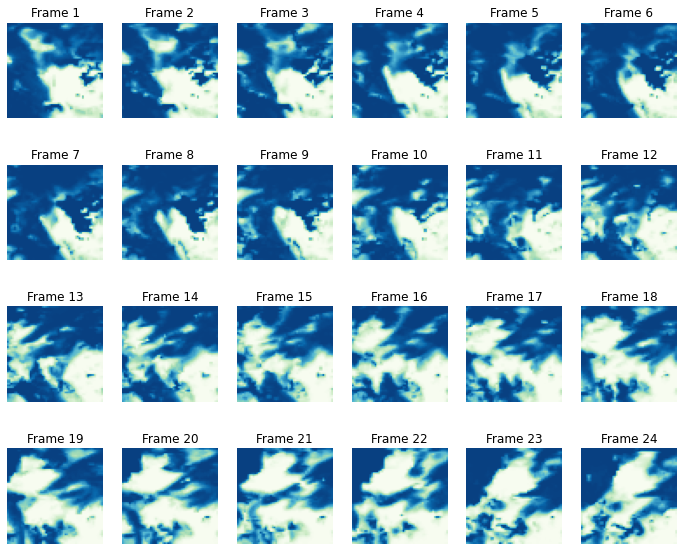

In [13]:
# Construct a figure on which we will visualize the images.
fig, axes = plt.subplots(4,6 , figsize=(12, 10))

# Plot each of the sequential images for one random data example.
data_choice = numpy.random.choice(range(len(train_dataset)), size=1)[0]
for idx, ax in enumerate(axes.flat):
    ax.imshow(numpy.squeeze(train_dataset[data_choice][idx]), cmap="GnBu")
    ax.set_title(f"Frame {idx + 1}")
    ax.axis("off")

# Print information and display the figure.
print(f"Displaying frames for example {data_choice}.")
plt.show()

### Next-frame prediction <a class="anchor" id="chapter3"></a>


### Importing libraries <a class="anchor" id="section_3_1"></a>


In [3]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import  save_model, load_model

import io
import imageio
from IPython.display import  display
from ipywidgets import widgets,  HBox


2022-07-30 21:39:13.619069: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-07-30 21:39:13.619110: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


### Defining the model <a class="anchor" id="section_3_2"></a>


The basis of the model for this exercise is the ConvLSTM2D archotecture. (cita articulo) (cita implementacion queras). This architecture is an extencion of the Long short-term memory (LSTM) type of networks usaly used to process data sequences as it retains feedback connections. The main change in ConvLSTM architectures is the way operations are done in the spatial domain of data, it is done via 2D convolutions rather than simple matrix operations. In addition Bathc normalzation is used between layers to stabilize and speed trainning. Finally a Conv3D layer, which performs convolutions over volumes, is introduced to account for the spatio temporal nature of the outputs. 


In [20]:
inp = layers.Input(shape=(None, *x_train.shape[2:]))

x = layers.ConvLSTM2D(
    filters=32,
    kernel_size=(5, 5),
    padding="same",
    return_sequences=True,
    activation="relu",
)(inp)
x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters=32,
    kernel_size=(3, 3),
    padding="same",
    return_sequences=True,
    activation="relu",
)(x)
x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters=32,
    kernel_size=(1, 1),
    padding="same",
    return_sequences=True,
    activation="relu",
)(x)
x = layers.Conv3D(
    filters=1, kernel_size=(3, 3, 3), activation="sigmoid", padding="same"
)(x)


model = keras.models.Model(inp, x)
model.compile(loss=keras.losses.MeanSquaredError(), optimizer=keras.optimizers.Adam(lr=0.000001))

c:\Users\jegom\Anaconda3\envs\wekeonote\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


### Tranning the model <a class="anchor" id="section_3_3"></a>


Before tranning the model we define an early stopping callback which will end the tranning if the validations loss of the model reach a minimun value and stabilizes for 10 epochs. Finally, epochs and the batch size is sablished.

In [ ]:
# Define some callbacks to improve training.
early_stopping = keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)

# Define modifiable training hyperparameters.
epochs = 100
batch_size = 1


# Fit the model to the training data.
model.fit(x_train,
    y_train,
    epochs=epochs,
    validation_data=(x_val, y_val),
    callbacks=[early_stopping],
)

Once the tranning has finished the model is saved in a h5 file which stores weights, architecture and parameters in a single file.

In [ ]:
save_model(model,workdir+'/model.h5')

### Making predictions <a class="anchor" id="section_3_4"></a>


The following block of code randomly selects one sample from the validation dataset and predicts 12 final truth frames with the predicted ones.

In [40]:
model = load_model(r'C:\Users\jegom\Desktop\model\Nodel.h5', compile = True)
model.summary()


2022-07-23 17:48:14,138 DEBUG Creating converter from 3 to 5


In [45]:
# Select a few random examples from the dataset.
examples = val_dataset[numpy.random.choice(range(len(val_dataset)), size=1)]

# Iterate over the examples and predict the frames.
predicted_videos = []
for example in examples:
    # Pick the first/last ten frames from the example.
    frames = example[:12, ...]
    original_frames = example[12:, ...]
    new_predictions = numpy.zeros(shape=(12, *frames[0].shape))

    # Predict a new set of 10 frames.
    for i in range(12):
        # Extract the model's prediction and post-process it.
        frames = example[: 12 + i + 1, ...]
        new_prediction = model.predict(numpy.expand_dims(frames, axis=0))
        new_prediction = numpy.squeeze(new_prediction, axis=0)
        predicted_frame = numpy.expand_dims(new_prediction[-1, ...], axis=0)

        # Extend the set of prediction frames.
        new_predictions[i] = predicted_frame

    # Create and save GIFs for each of the ground truth/prediction images.
    for frame_set in [original_frames, new_predictions]:
        # Construct a GIF from the selected video frames.
        current_frames = numpy.squeeze(frame_set)
        current_frames = current_frames[..., numpy.newaxis] * numpy.ones(3)
        current_frames = (current_frames * 255).astype(numpy.uint8)
        current_frames = list(current_frames)

        # Construct a GIF from the frames.
        with io.BytesIO() as gif:
            imageio.mimsave(gif, current_frames, "GIF", fps=5)
            predicted_videos.append(gif.getvalue())

# Display the videos.
print(" Truth\tPrediction")
for i in range(0, len(predicted_videos), 2):
    # Construct and display an `HBox` with the ground truth and prediction.
    box = HBox(
        [
            widgets.Image(value=predicted_videos[i],width=300,height=200),
            widgets.Image(value=predicted_videos[i + 1],width=300,height=200),
        ]
    )
    display(box)

1/1 [==============================] - 0s 147ms/step
 Truth	Prediction


Finally we use a date outside the original timelapse and make a prediction on it

In [47]:
validation_date=xr.open_dataset(r'C:\Users\jegom\Desktop\data\validation.nc')
validation_date=data.tcc.to_numpy()
nvalidation_date = numpy.expand_dims(np, axis=-1)


In [48]:
# Select a few random examples from the dataset.
examples = [nvalidation_date]

# Iterate over the examples and predict the frames.
predicted_videos = []
for example in examples:
    # Pick the first/last ten frames from the example.
    frames = example[:12, ...]
    original_frames = example[12:, ...]
    new_predictions = numpy.zeros(shape=(12, *frames[0].shape))

    # Predict a new set of 10 frames.
    for i in range(12):
        # Extract the model's prediction and post-process it.
        frames = example[: 12 + i + 1, ...]
        new_prediction = model.predict(numpy.expand_dims(frames, axis=0))
        new_prediction = numpy.squeeze(new_prediction, axis=0)
        predicted_frame = numpy.expand_dims(new_prediction[-1, ...], axis=0)

        # Extend the set of prediction frames.
        new_predictions[i] = predicted_frame

    # Create and save GIFs for each of the ground truth/prediction images.
    for frame_set in [original_frames, new_predictions]:
        # Construct a GIF from the selected video frames.
        current_frames = numpy.squeeze(frame_set)
        current_frames = current_frames[..., numpy.newaxis] * numpy.ones(3)
        current_frames = (current_frames * 255).astype(numpy.uint8)
        current_frames = list(current_frames)

        # Construct a GIF from the frames.
        with io.BytesIO() as gif:
            imageio.mimsave(gif, current_frames, "GIF", fps=5)
            predicted_videos.append(gif.getvalue())

# Display the videos.
print(" Truth\tPrediction")
for i in range(0, len(predicted_videos), 2):
    # Construct and display an `HBox` with the ground truth and prediction.
    box = HBox(
        [
            widgets.Image(value=predicted_videos[i],width=300,height=200),
            widgets.Image(value=predicted_videos[i + 1],width=300,height=200),
        ]
    )
    display(box)

1/1 [==============================] - 0s 159ms/step
 Truth	Prediction
